# Подготовка данных

# 0. Импорт сторонних библиотек

In [1]:
import pandas as pd
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

from sklearn.model_selection import train_test_split

from sklearn.preprocessing import OneHotEncoder, StandardScaler

import warnings
warnings.filterwarnings('ignore')

## 0.1 Настройки среды, объявление глобальных переменных

In [2]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

RANDOM_SEED = 42

# 1. Чтение исходного датасета

In [3]:
df = pd.read_csv('../data/WA_Fn-UseC_-HR-Employee-Attrition.csv')
df.shape

(1470, 35)

In [4]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,Y,No,23,4,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Y,Yes,15,3,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Y,Yes,11,3,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,Y,No,12,3,4,80,1,6,3,3,2,2,2,2


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

# 2. Первичный просмотр

In [6]:
df[df.duplicated()]

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager


In [7]:
df.isna().any()

Age                         False
Attrition                   False
BusinessTravel              False
DailyRate                   False
Department                  False
DistanceFromHome            False
Education                   False
EducationField              False
EmployeeCount               False
EmployeeNumber              False
EnvironmentSatisfaction     False
Gender                      False
HourlyRate                  False
JobInvolvement              False
JobLevel                    False
JobRole                     False
JobSatisfaction             False
MaritalStatus               False
MonthlyIncome               False
MonthlyRate                 False
NumCompaniesWorked          False
Over18                      False
OverTime                    False
PercentSalaryHike           False
PerformanceRating           False
RelationshipSatisfaction    False
StandardHours               False
StockOptionLevel            False
TotalWorkingYears           False
TrainingTimesL

In [8]:
for col in df.columns:
    print(f'{col}:\n{df[col].unique()}')

Age:
[41 49 37 33 27 32 59 30 38 36 35 29 31 34 28 22 53 24 21 42 44 46 39 43
 50 26 48 55 45 56 23 51 40 54 58 20 25 19 57 52 47 18 60]
Attrition:
['Yes' 'No']
BusinessTravel:
['Travel_Rarely' 'Travel_Frequently' 'Non-Travel']
DailyRate:
[1102  279 1373 1392  591 1005 1324 1358  216 1299  809  153  670 1346
  103 1389  334 1123 1219  371  673 1218  419  391  699 1282 1125  691
  477  705  924 1459  125  895  813 1273  869  890  852 1141  464 1240
 1357  994  721 1360 1065  408 1211 1229  626 1434 1488 1097 1443  515
  853 1142  655 1115  427  653  989 1435 1223  836 1195 1339  664  318
 1225 1328 1082  548  132  746  776  193  397  945 1214  111  573 1153
 1400  541  432  288  669  530  632 1334  638 1093 1217 1353  120  682
  489  807  827  871  665 1040 1420  240 1280  534 1456  658  142 1127
 1031 1189 1354 1467  922  394 1312  750  441  684  249  841  147  528
  594  470  957  542  802 1355 1150 1329  959 1033 1316  364  438  689
  201 1427  857  933 1181 1395  662 1436  194  967 

Все ли признаки нужно оставить для дальнейшей работы над моделью?<br>
*Нет, некоторые признакине не несут информативности для будущей модели*


Какие признаки можно удалить и почем<br>
*Можно исключить следующие признаки:*<br>
*у?EmployeeCou - данный признак имеет одно значение для всех примеров и не несёт информационной нагрузки для модели*<br>
*, EmployeeNumb - данный признак является идентификатором работника (табельный номер) и не несёт информационной нагрузки для модели*<br>
*, Over - данный признак так же имеет одно значение для всех примеров, т.к. трудовой возраст всегда > 18 лет, поэтому его можно исключить*<br>
*, StandardHou - так же как и предыдущий, данный признак имеет одинаковое значение для всех примеров выборки, его можно исключить по причине не информативности*<br>, 

In [9]:
cols_for_del = ['EmployeeCount', 'EmployeeNumber', 'Over18', 'StandardHours']

In [10]:
df_clear = df.drop(cols_for_del, axis = 1)

# 3. Визуализации и зависимости

## 3.1 Матрица корреляции

In [11]:
corr = df_clear.select_dtypes('number').corr()

In [12]:
corr

,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Age,1.000000,0.010661,-0.001686,0.208034,0.010146,0.024287,0.029820,0.509604,-0.004892,0.497855,0.028051,0.299635,0.003634,0.001904,0.053535,0.037510,0.680381,-0.019621,-0.021490,0.311309,0.212901,0.216513,0.202089
DailyRate,0.010661,1.000000,-0.004985,-0.016806,0.018355,0.023381,0.046135,0.002966,0.030571,0.007707,-0.032182,0.038153,0.022704,0.000473,0.007846,0.042143,0.014515,0.002453,-0.037848,-0.034055,0.009932,-0.033229,-0.026363
DistanceFromHome,-0.001686,-0.004985,1.000000,0.021042,-0.016075,0.031131,0.008783,0.005303,-0.003669,-0.017014,0.027473,-0.029251,0.040235,0.027110,0.006557,0.044872,0.004628,-0.036942,-0.026556,0.009508,0.018845,0.010029,0.014406
Education,0.208034,-0.016806,0.021042,1.000000,-0.027128,0.016775,0.042438,0.101589,-0.011296,0.094961,-0.026084,0.126317,-0.011111,-0.024539,-0.009118,0.018422,0.148280,-0.025100,0.009819,0.069114,0.060236,0.054254,0.069065
EnvironmentSatisfaction,0.010146,0.018355,-0.016075,-0.027128,1.000000,-0.049857,-0.008278,0.001212,-0.006784,-0.006259,0.037600,0.012594,-0.031701,-0.029548,0.007665,0.003432,-0.002693,-0.019359,0.027627,0.001458,0.018007,0.016194,-0.004999
HourlyRate,0.024287,0.023381,0.031131,0.016775,-0.049857,1.000000,0.042861,-0.027853,-0.071335,-0.015794,-0.015297,0.022157,-0.009062,-0.002172,0.001330,0.050263,-0.002334,-0.008548,-0.004607,-0.019582,-0.024106,-0.026716,-0.020123
JobInvolvement,0.029820,0.046135,0.008783,0.042438,-0.008278,0.042861,1.000000,-0.012630,-0.021476,-0.015271,-0.016322,0.015012,-0.017205,-0.029071,0.034297,0.021523,-0.005533,-0.015338,-0.014617,-0.021355,0.008717,-0.024184,0.025976
JobLevel,0.509604,0.002966,0.005303,0.101589,0.001212,-0.027853,-0.012630,1.000000,-0.001944,0.950300,0.039563,0.142501,-0.034730,-0.021222,0.021642,0.013984,0.782208,-0.018191,0.037818,0.534739,0.389447,0.353885,0.375281
JobSatisfaction,-0.004892,0.030571,-0.003669,-0.011296,-0.006784,-0.071335,-0.021476,-0.001944,1.000000,-0.007157,0.000644,-0.055699,0.020002,0.002297,-0.012454,0.010690,-0.020185,-0.005779,-0.019459,-0.003803,-0.002305,-0.018214,-0.027656
MonthlyIncome,0.497855,0.007707,-0.017014,0.094961,-0.006259,-0.015794,-0.015271,0.950300,-0.007157,1.000000,0.034814,0.149515,-0.027269,-0.017120,0.025873,0.005408,0.772893,-0.021736,0.030683,0.514285,0.363818,0.344978,0.344079


## 3.2 Тепловая карта

<Axes: >

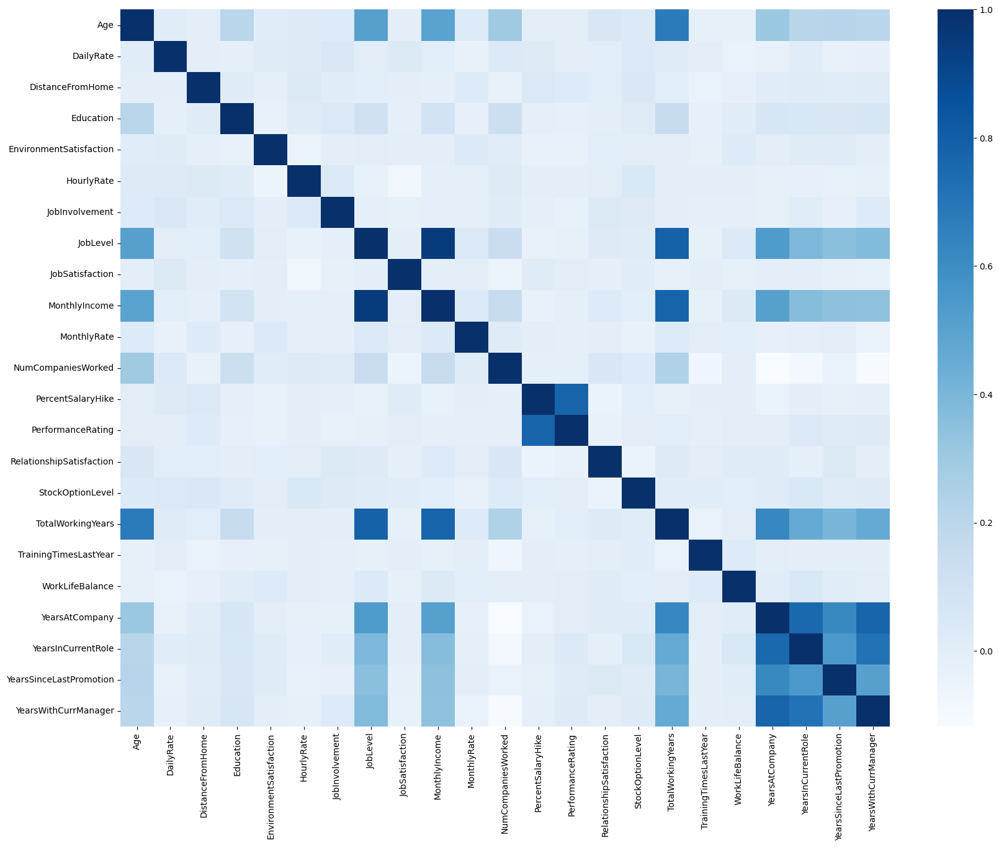

In [13]:
plt.subplots(figsize=(20,15))
sns.heatmap(corr, cmap="Blues")

## 3.3 Гистограммы по признакам

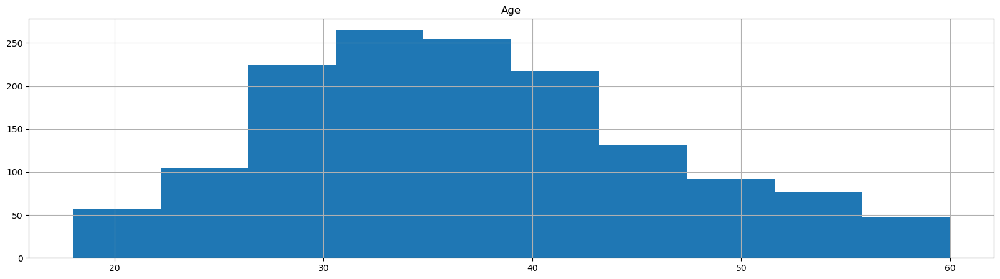

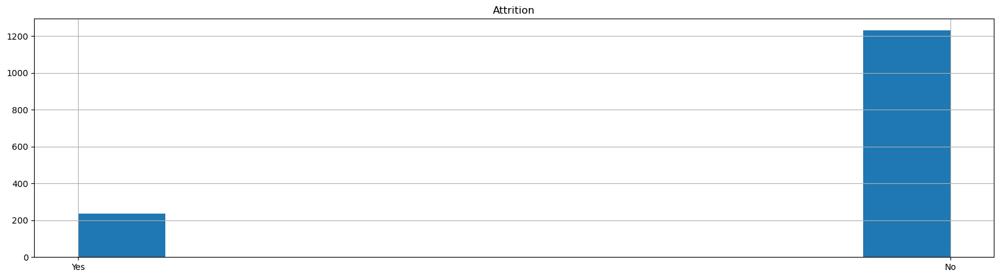

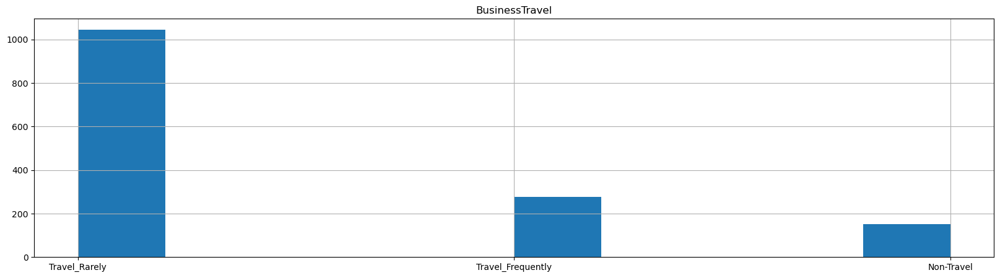

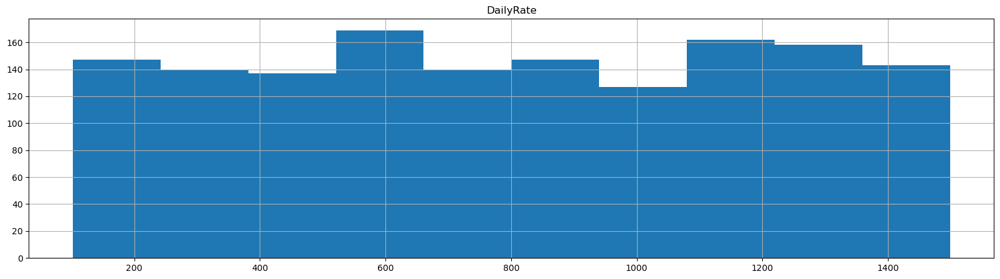

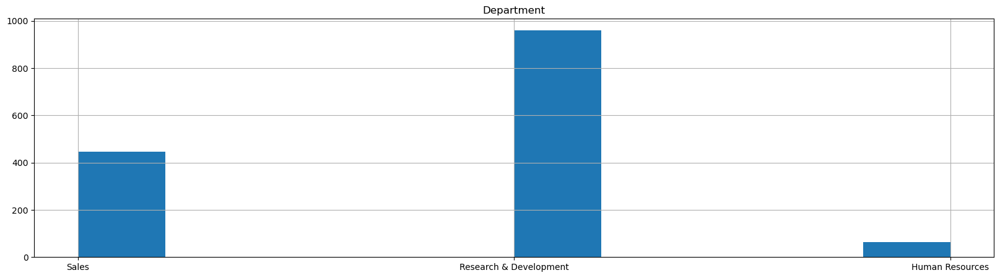

...

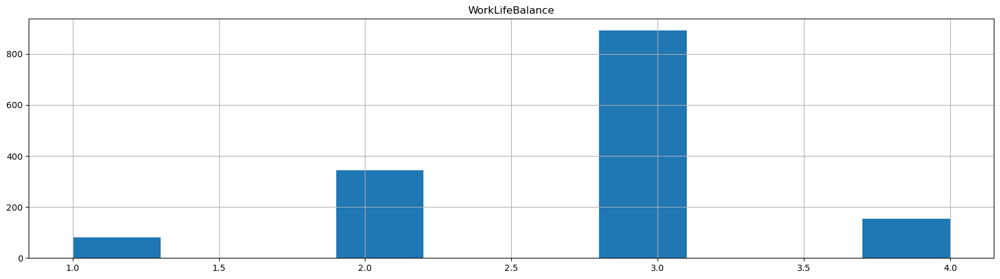

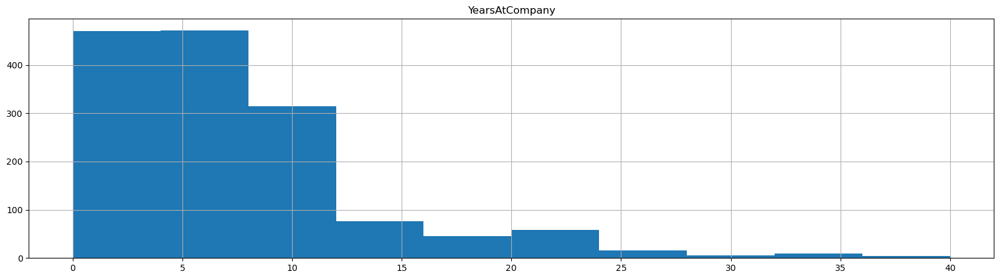

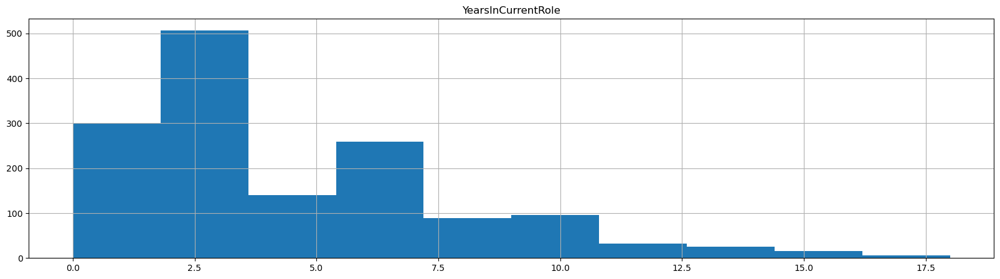

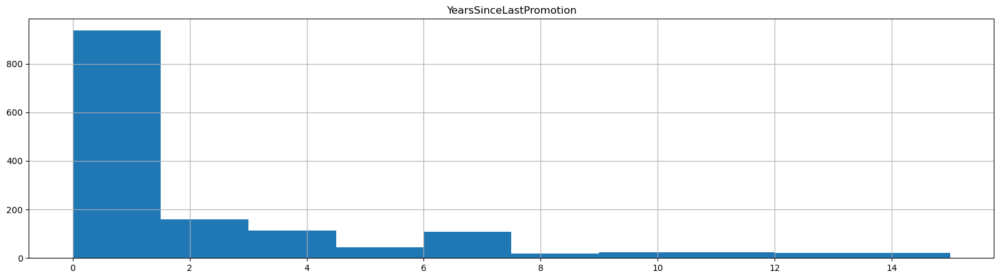

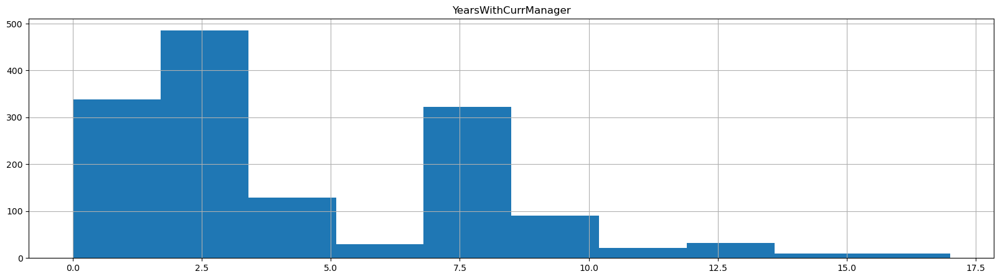

In [15]:
for col in df_clear.columns:
    plt.subplots(figsize=(20,5))
    plt.title(col)
    df_clear[col].hist()
    plt.show()

## 3.4 Диаграммы "Ящик с усами"

In [15]:
df_num_cols = df_clear.select_dtypes('number').columns
df_cat_columns = df_clear.select_dtypes('object').columns.drop('Attrition')

Статистика для колонки 'Age':
Минимум: 18
1-ый квартиль (25%): 30.0
Медиана (50%): 36.0
3-й квартиль (75%): 43.0
Максимум: 60


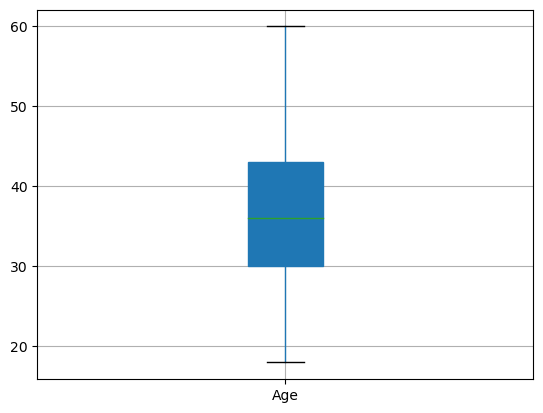

Статистика для колонки 'DailyRate':
Минимум: 102
1-ый квартиль (25%): 465.0
Медиана (50%): 802.0
3-й квартиль (75%): 1157.0
Максимум: 1499


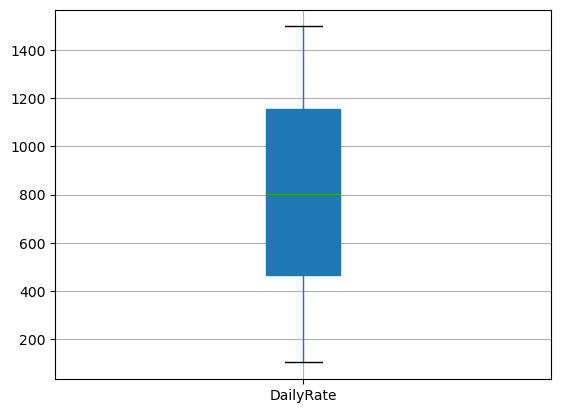

Статистика для колонки 'DistanceFromHome':
Минимум: 1
1-ый квартиль (25%): 2.0
Медиана (50%): 7.0
3-й квартиль (75%): 14.0
Максимум: 29


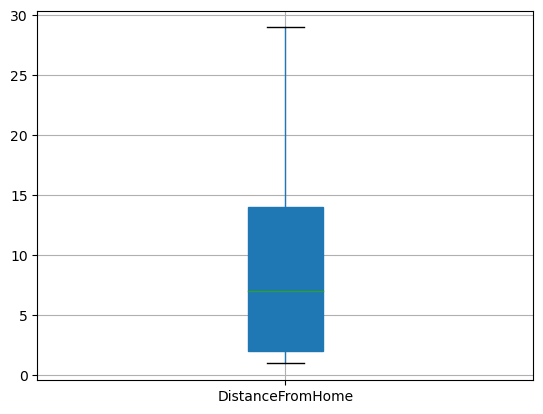

Статистика для колонки 'Education':
Минимум: 1
1-ый квартиль (25%): 2.0
Медиана (50%): 3.0
3-й квартиль (75%): 4.0
Максимум: 5


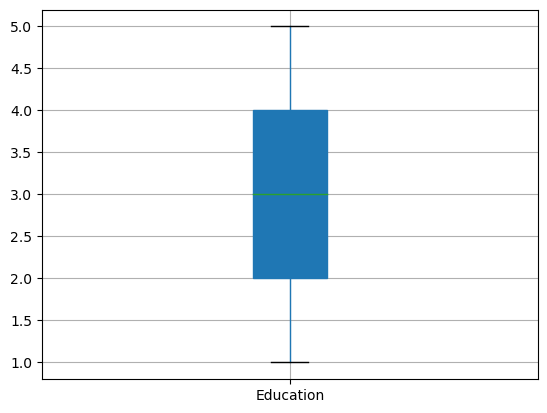

Статистика для колонки 'EnvironmentSatisfaction':
Минимум: 1
1-ый квартиль (25%): 2.0
Медиана (50%): 3.0
3-й квартиль (75%): 4.0
Максимум: 4


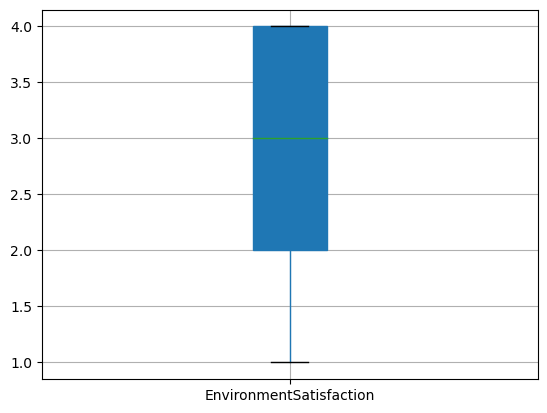

Статистика для колонки 'HourlyRate':
Минимум: 30
1-ый квартиль (25%): 48.0
Медиана (50%): 66.0
3-й квартиль (75%): 83.75
Максимум: 100


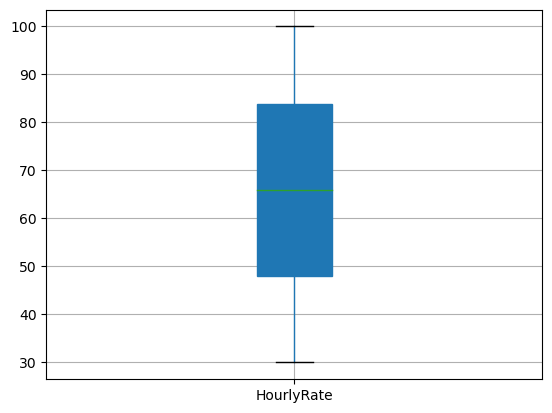

Статистика для колонки 'JobInvolvement':
Минимум: 1
1-ый квартиль (25%): 2.0
Медиана (50%): 3.0
3-й квартиль (75%): 3.0
Максимум: 4


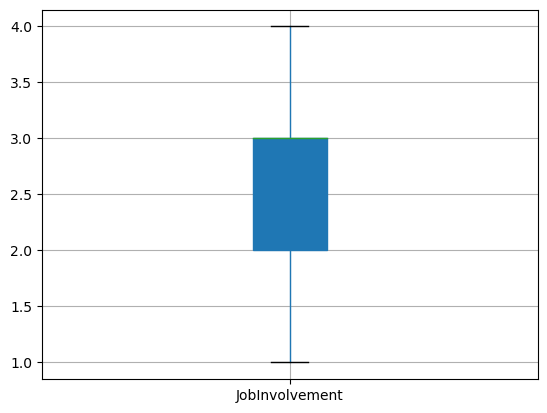

Статистика для колонки 'JobLevel':
Минимум: 1
1-ый квартиль (25%): 1.0
Медиана (50%): 2.0
3-й квартиль (75%): 3.0
Максимум: 5


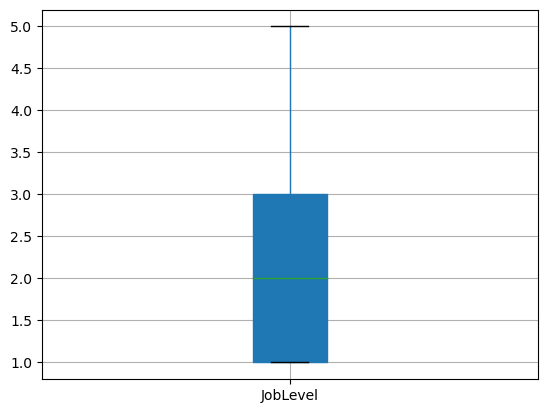

Статистика для колонки 'JobSatisfaction':
Минимум: 1
1-ый квартиль (25%): 2.0
Медиана (50%): 3.0
3-й квартиль (75%): 4.0
Максимум: 4


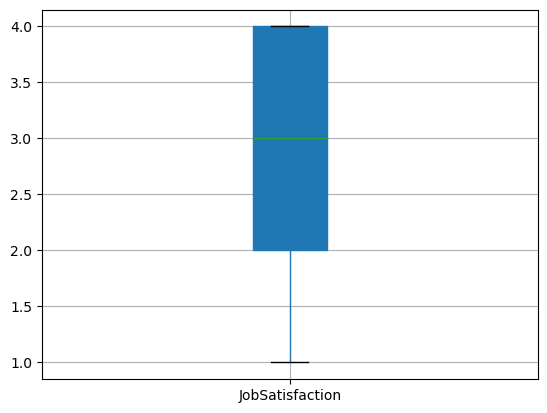

Статистика для колонки 'MonthlyIncome':
Минимум: 1009
1-ый квартиль (25%): 2911.0
Медиана (50%): 4919.0
3-й квартиль (75%): 8379.0
Максимум: 19999


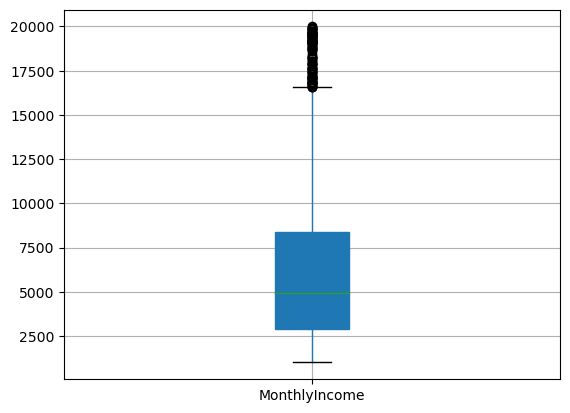

Статистика для колонки 'MonthlyRate':
Минимум: 2094
1-ый квартиль (25%): 8047.0
Медиана (50%): 14235.5
3-й квартиль (75%): 20461.5
Максимум: 26999


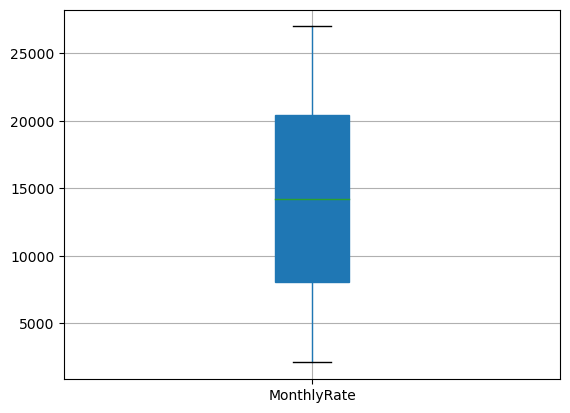

Статистика для колонки 'NumCompaniesWorked':
Минимум: 0
1-ый квартиль (25%): 1.0
Медиана (50%): 2.0
3-й квартиль (75%): 4.0
Максимум: 9


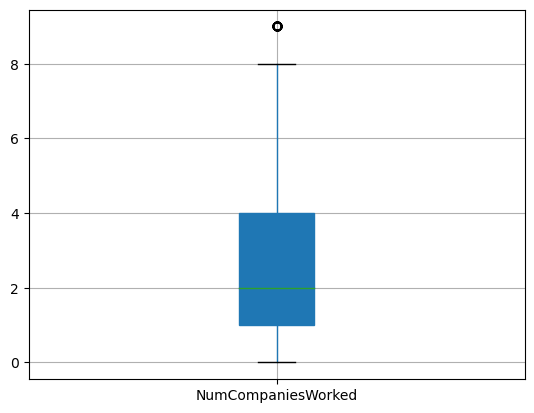

Статистика для колонки 'PercentSalaryHike':
Минимум: 11
1-ый квартиль (25%): 12.0
Медиана (50%): 14.0
3-й квартиль (75%): 18.0
Максимум: 25


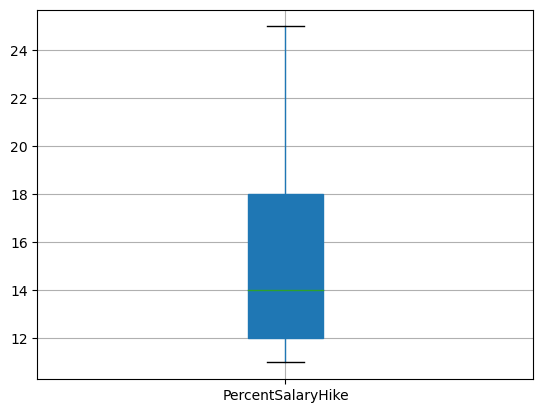

Статистика для колонки 'PerformanceRating':
Минимум: 3
1-ый квартиль (25%): 3.0
Медиана (50%): 3.0
3-й квартиль (75%): 3.0
Максимум: 4


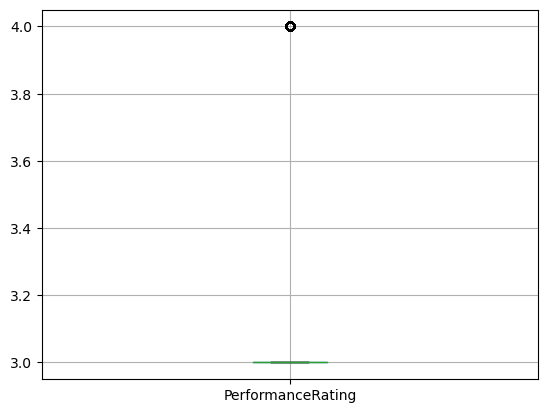

Статистика для колонки 'RelationshipSatisfaction':
Минимум: 1
1-ый квартиль (25%): 2.0
Медиана (50%): 3.0
3-й квартиль (75%): 4.0
Максимум: 4


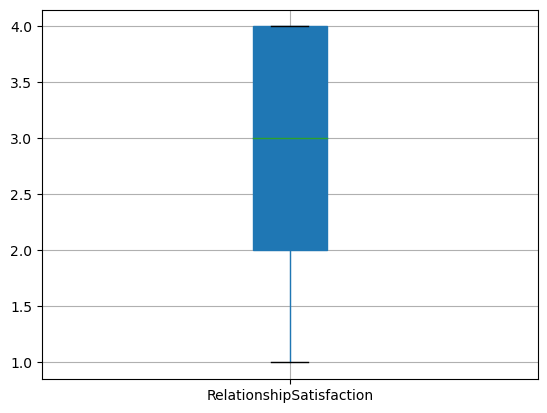

Статистика для колонки 'StockOptionLevel':
Минимум: 0
1-ый квартиль (25%): 0.0
Медиана (50%): 1.0
3-й квартиль (75%): 1.0
Максимум: 3


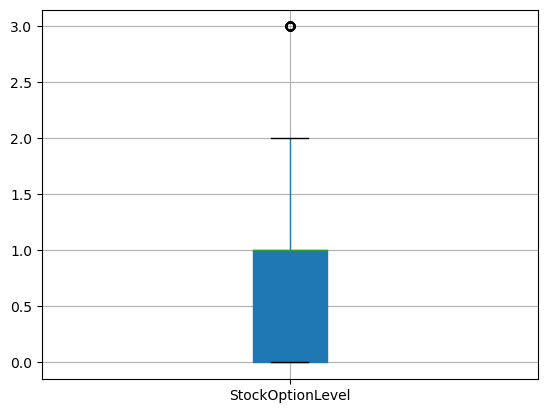

Статистика для колонки 'TotalWorkingYears':
Минимум: 0
1-ый квартиль (25%): 6.0
Медиана (50%): 10.0
3-й квартиль (75%): 15.0
Максимум: 40


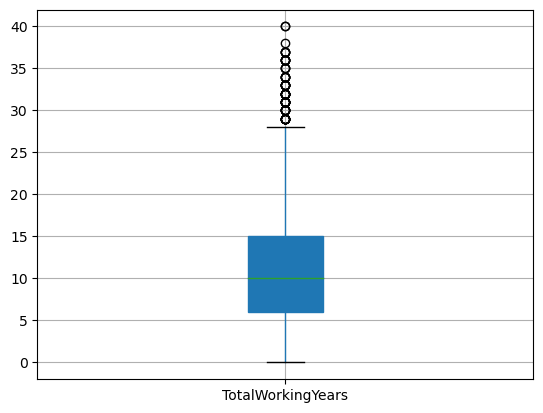

Статистика для колонки 'TrainingTimesLastYear':
Минимум: 0
1-ый квартиль (25%): 2.0
Медиана (50%): 3.0
3-й квартиль (75%): 3.0
Максимум: 6


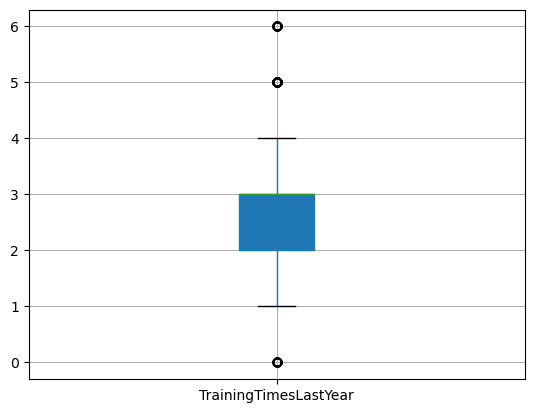

Статистика для колонки 'WorkLifeBalance':
Минимум: 1
1-ый квартиль (25%): 2.0
Медиана (50%): 3.0
3-й квартиль (75%): 3.0
Максимум: 4


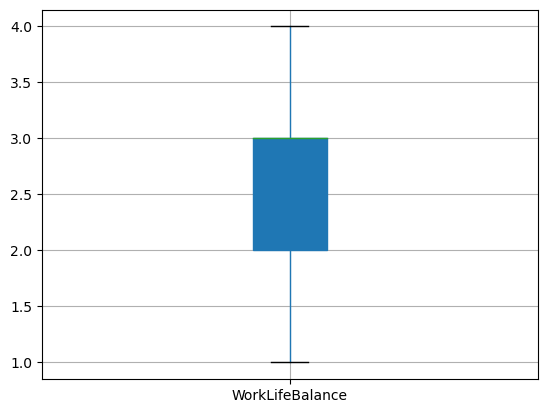

Статистика для колонки 'YearsAtCompany':
Минимум: 0
1-ый квартиль (25%): 3.0
Медиана (50%): 5.0
3-й квартиль (75%): 9.0
Максимум: 40


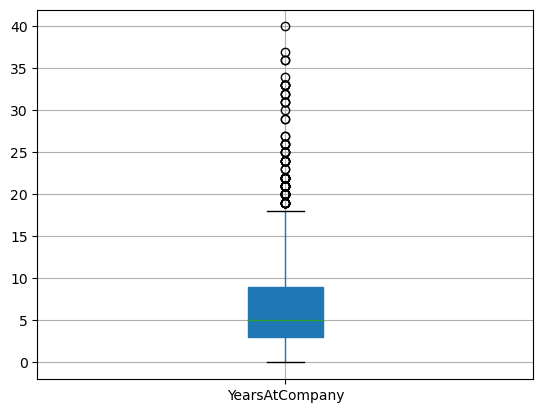

Статистика для колонки 'YearsInCurrentRole':
Минимум: 0
1-ый квартиль (25%): 2.0
Медиана (50%): 3.0
3-й квартиль (75%): 7.0
Максимум: 18


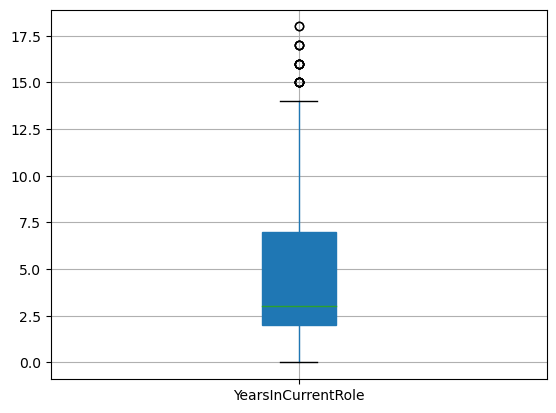

Статистика для колонки 'YearsSinceLastPromotion':
Минимум: 0
1-ый квартиль (25%): 0.0
Медиана (50%): 1.0
3-й квартиль (75%): 3.0
Максимум: 15


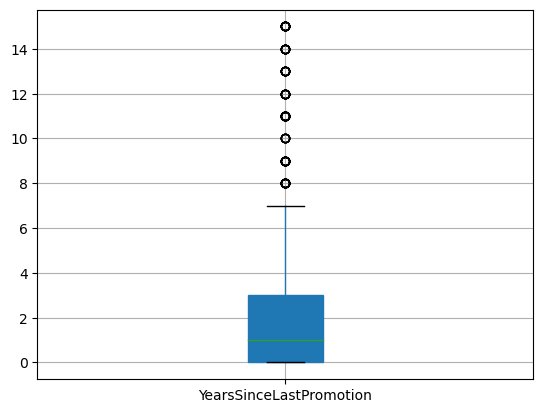

Статистика для колонки 'YearsWithCurrManager':
Минимум: 0
1-ый квартиль (25%): 2.0
Медиана (50%): 3.0
3-й квартиль (75%): 7.0
Максимум: 17


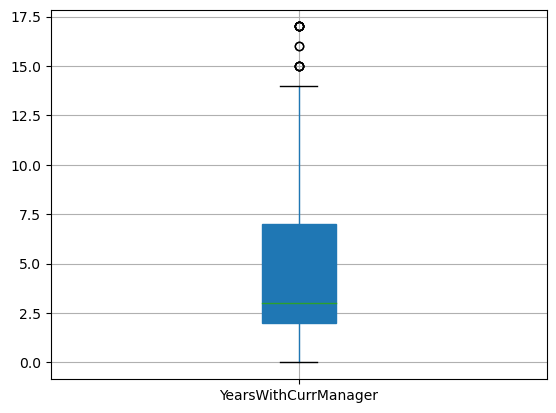

In [18]:
#plt.subplots(figsize=(50,30))
for col in df_num_cols:
    print(f'Статистика для колонки \'{col}\':\nМинимум: {df_clear[col].min()}\n1-ый квартиль (25%): {df_clear[col].quantile(0.25)}\nМедиана (50%): {df_clear[col].median()}\n3-й квартиль (75%): {df_clear[col].quantile(0.75)}\nМаксимум: {df_clear[col].max()}')
    
    bp = df_clear.boxplot(patch_artist=True, column=[col], return_type='axes');
    #bp.set_facecolor('lightgreen')
    plt.show()

*Анализ признаков содержащих выбросы показал, что значения не являются аномалиями либо ошибками формирования данных.*

In [17]:
df_a = df_clear.copy()

In [18]:
df_a['Attrition'] = [1 if x == 'Yes' else 0 for x in df_a['Attrition']]

## 3.5 Диаграммы рассеяния

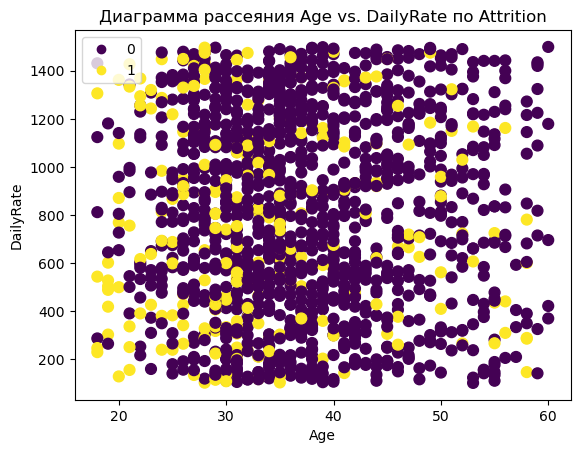

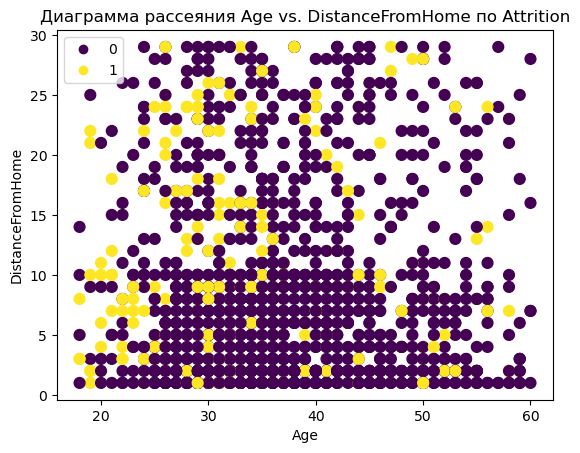

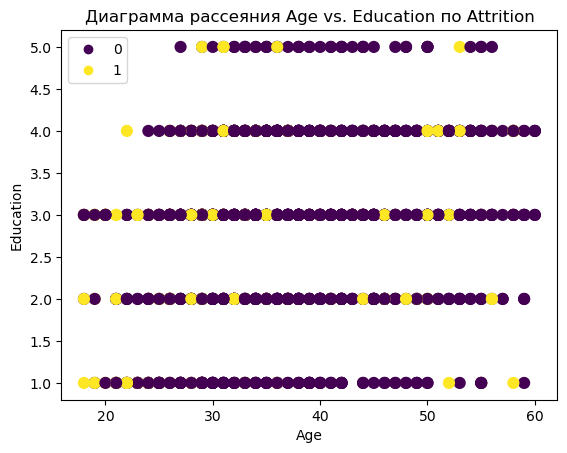

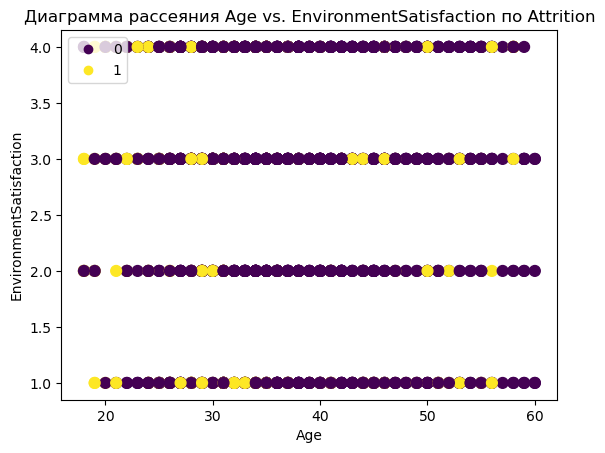

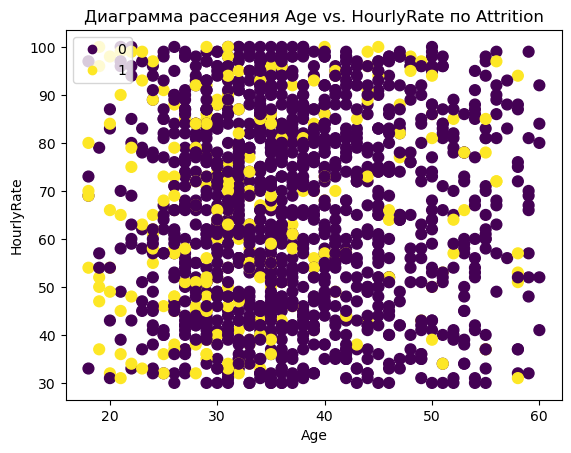

...

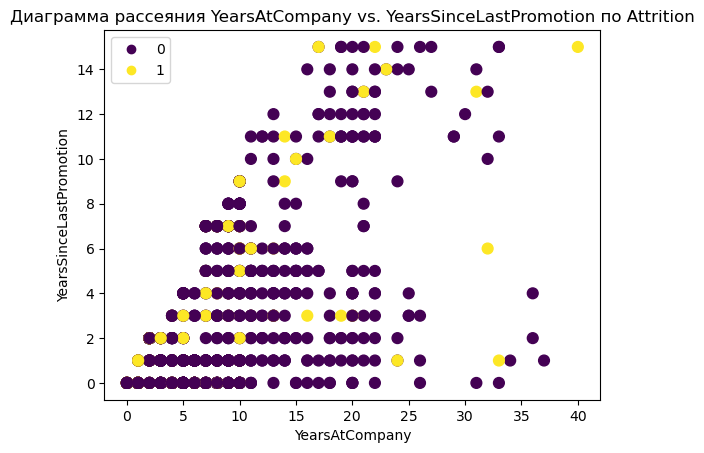

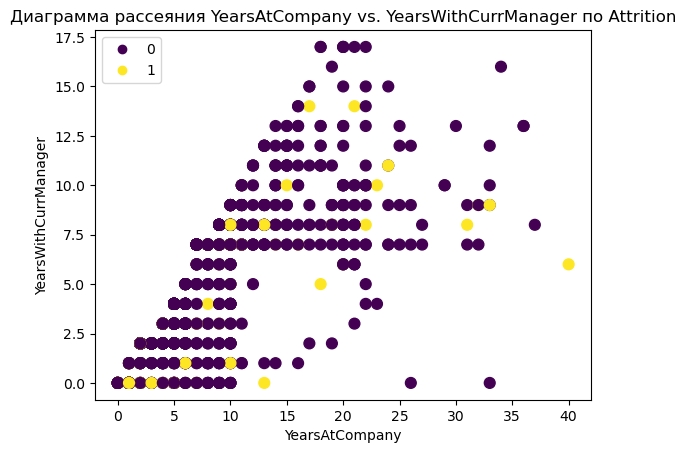

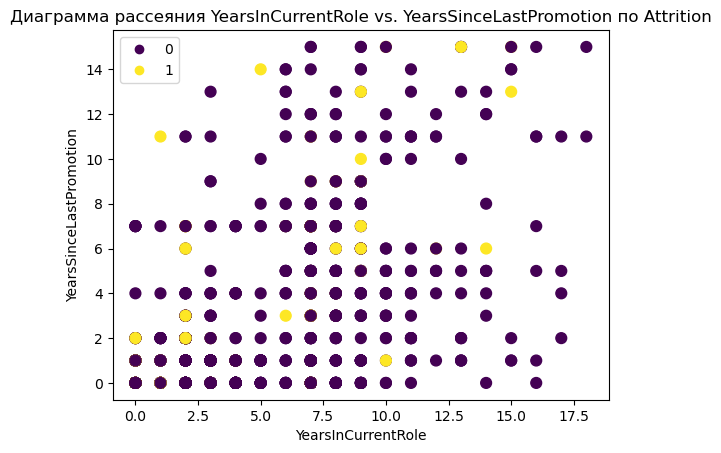

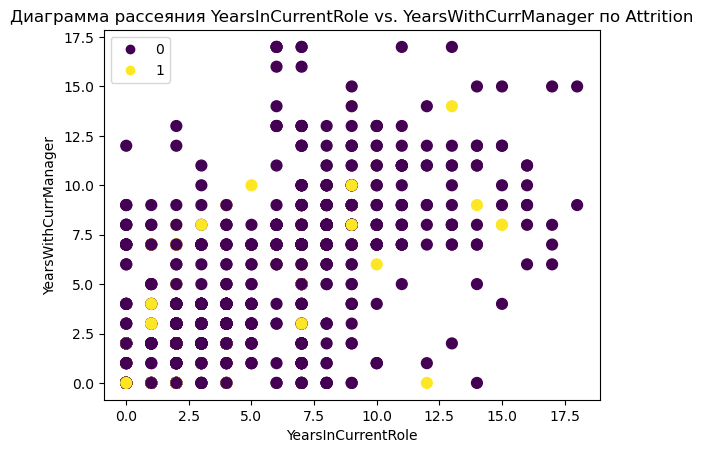

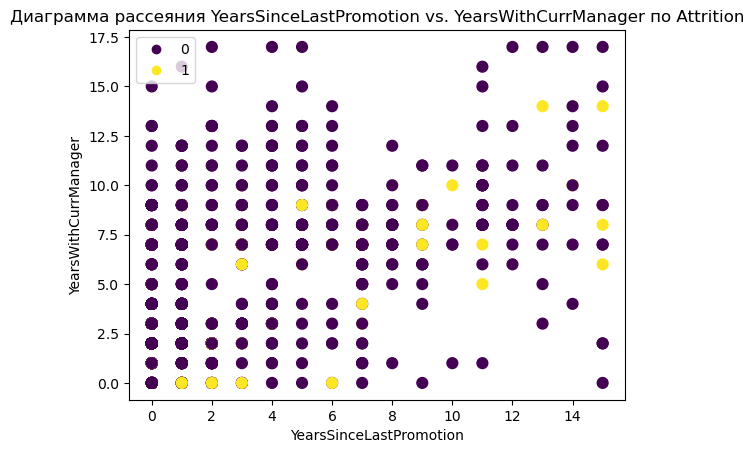

In [25]:
#df_num_columns = df_a.select_dtypes('number').columns.drop('Attrition')
#df_num_columns = df_a.columns.drop('Attrition')
u = np.unique(df_a.Attrition.values)
for i in df_num_cols:
    for j in df_num_cols.drop(i):
        scatter = plt.scatter(x = df_a[i], y = df_a[j], s= 60, c=df_a['Attrition'])
        plt.xlabel(i)
        plt.ylabel(j)
        plt.title(f'Диаграмма рассеяния {i} vs. {j} по Attrition')
        plt.legend(scatter.legend_elements()[0], u, loc=2)
        plt.show()
    df_num_cols = df_num_cols.drop(i)

## 3.6 Столбчатые диаграммы

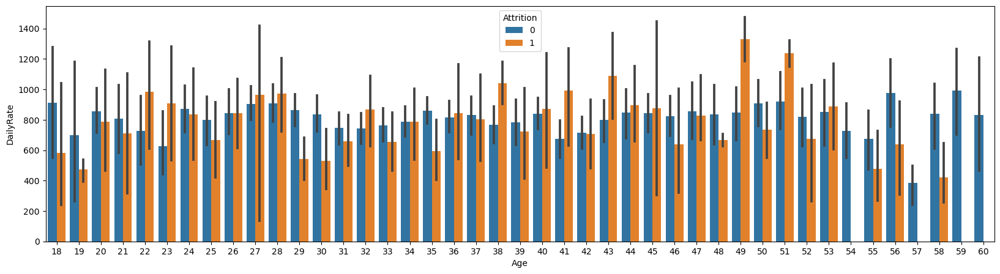

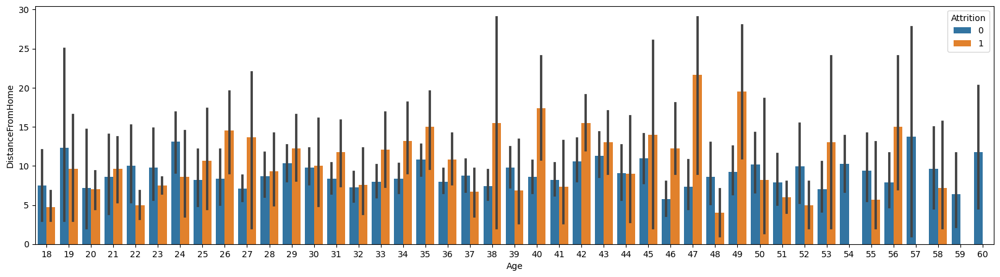

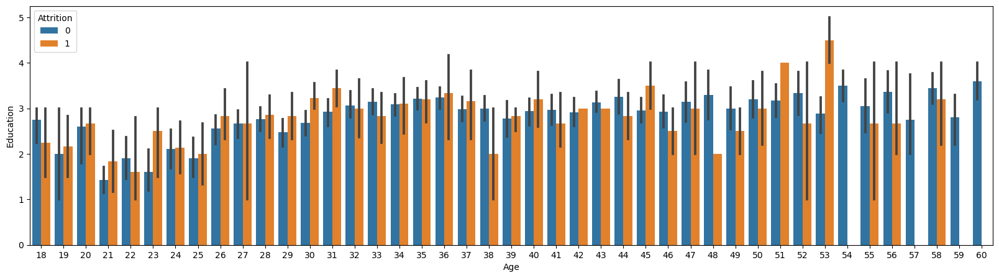

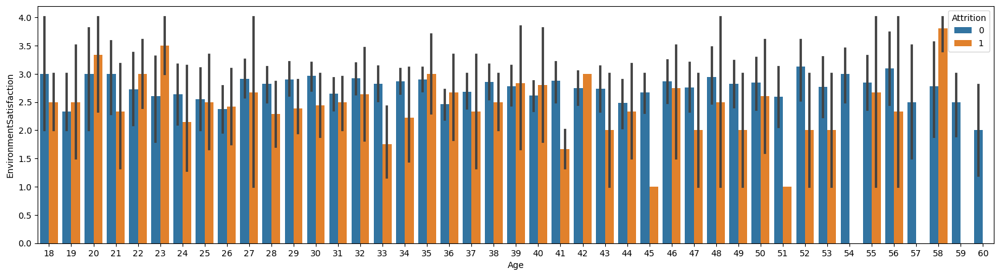

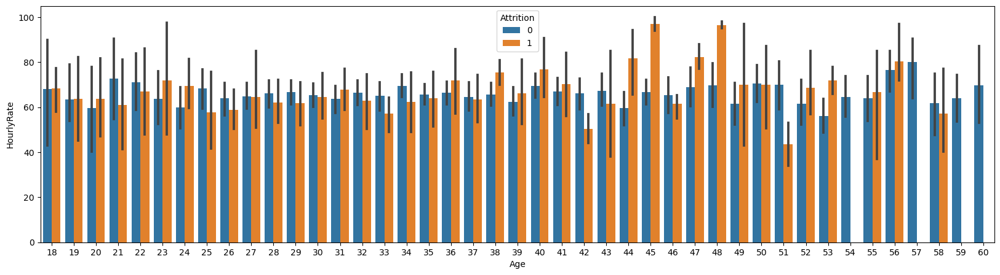

...

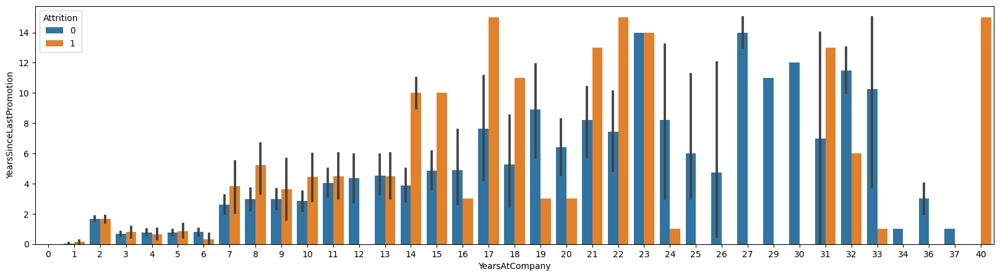

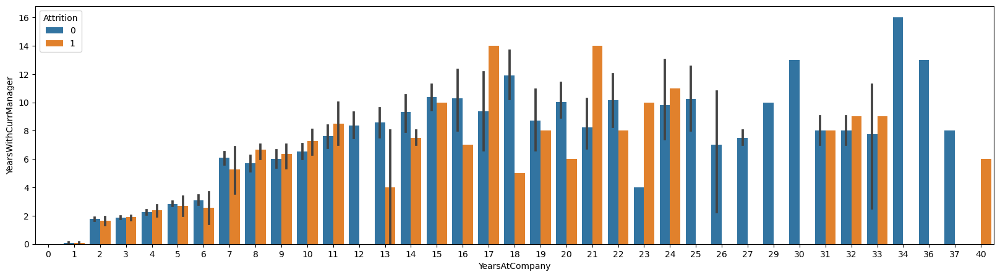

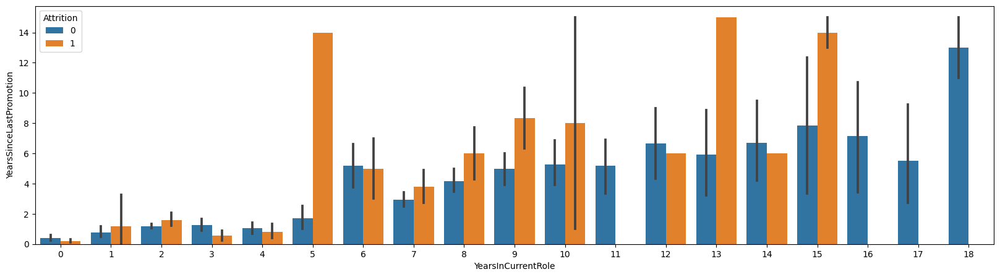

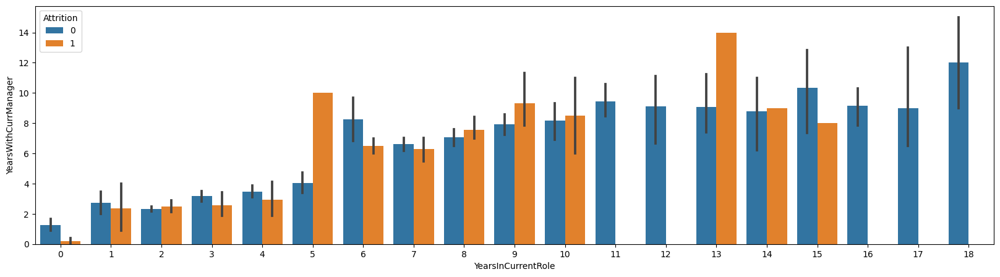

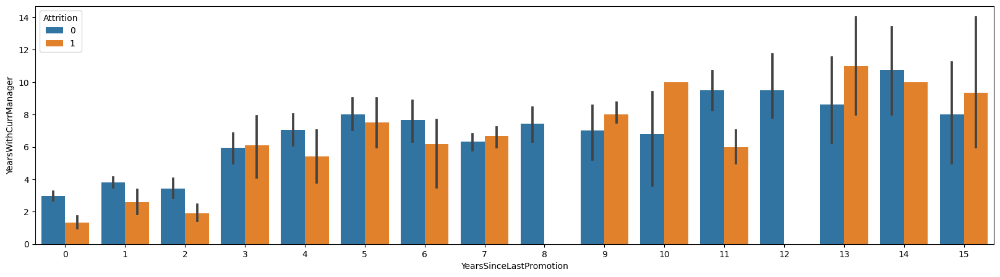

In [27]:
df_num_cols = df_a.select_dtypes('number').columns.drop('Attrition')
for i in df_num_cols:
    for j in df_num_cols.drop(i):
        fig, ax = plt.subplots(figsize=(20, 5))
        sns.barplot(x=i, y=j, hue=df_a['Attrition'], data=df_a, ax=ax)
        #plt.figure(figsize=(20,5))
        plt.show()
    df_num_cols = df_num_cols.drop(i)    

*Необходимо оставить все признаки*

## 3.7 Информация о выбросах

In [20]:
def calculate_outliers(data):
    q25 = data.quantile(0.25)
    q75 = data.quantile(0.75)
    iqr = q75 - q25
    boundaries = (q25 - 1.5 * iqr, q75 + 1.5 * iqr)
    return boundaries

In [21]:
df_a.YearsWithCurrManager.describe()

count    1470.000000
mean        4.123129
std         3.568136
min         0.000000
25%         2.000000
50%         3.000000
75%         7.000000
max        17.000000
Name: YearsWithCurrManager, dtype: float64

In [22]:
#df_a[(df_a.YearsAtCompany > 18.0)]

In [23]:
df_num_cols = df_a.select_dtypes('number').columns.drop('Attrition')
for col in df_num_cols:
    boundaries = calculate_outliers(df_a[col])
    is_outlier = (df_a[col] > boundaries[1]) | (df_a[col] < boundaries[0] )
    outliers_count = is_outlier.sum()
    if outliers_count > 0:
        print(f'"""\nВыбросы для признака \'{col}\':\nГраницы для нормальных значений с интерквартильным размахом: {boundaries}\nКоличество выбросов: {outliers_count}\nДоля выбросов: {outliers_count/df_a.shape[0]} в процентах\n"""\n')

"""
Выбросы для признака 'MonthlyIncome':
Границы для нормальных значений с интерквартильным размахом: (-5291.0, 16581.0)
Количество выбросов: 114
Доля выбросов: 0.07755102040816327 в процентах
"""

"""
Выбросы для признака 'NumCompaniesWorked':
Границы для нормальных значений с интерквартильным размахом: (-3.5, 8.5)
Количество выбросов: 52
Доля выбросов: 0.03537414965986395 в процентах
"""

"""
Выбросы для признака 'PerformanceRating':
Границы для нормальных значений с интерквартильным размахом: (3.0, 3.0)
Количество выбросов: 226
Доля выбросов: 0.15374149659863945 в процентах
"""

"""
Выбросы для признака 'StockOptionLevel':
Границы для нормальных значений с интерквартильным размахом: (-1.5, 2.5)
Количество выбросов: 85
Доля выбросов: 0.05782312925170068 в процентах
"""

"""
Выбросы для признака 'TotalWorkingYears':
Границы для нормальных значений с интерквартильным размахом: (-7.5, 28.5)
Количество выбросов: 63
Доля выбросов: 0.04285714285714286 в процентах
"""

"""
Выбросы для приз

In [24]:
df_num_cols

Index(['Age', 'DailyRate', 'DistanceFromHome', 'Education', 'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager'], dtype='object')

In [ ]:
data.quantile(0.25)

*Сгенерированы дополнительные признаки, что позволило улучшить показатель метрики Accuracy на 2 процента*

In [34]:
df_a['Age_category'] = df_a.Age.apply(lambda x: 'Old' if x > df_a.Age.quantile(0.75) else ('Middle' if x <= df_a.Age.quantile(0.75) and x > df_a.Age.quantile(0.25) else 'Young') )
df_a['DailyRate_category'] = df_a.DailyRate.apply(lambda x: 'High' if x > df_a.DailyRate.quantile(0.75) else ('Middle' if x <= df_a.DailyRate.quantile(0.75) and x > df_a.DailyRate.quantile(0.25) else 'Small') )
df_a['DistanceFromHome_category'] = df_a.DistanceFromHome.apply(lambda x: 'Far' if x > df_a.DistanceFromHome.quantile(0.75) else ('Middle' if x <= df_a.DistanceFromHome.quantile(0.75) and x > df_a.DistanceFromHome.quantile(0.25) else 'Close') )
df_a['Education_category'] = df_a.Education.apply(lambda x: 'High' if x > df_a.Education.quantile(0.75) else ('Middle' if x <= df_a.Education.quantile(0.75) and x > df_a.Education.quantile(0.25) else 'Small') )
df_a['EnvironmentSatisfaction_category'] = df_a.EnvironmentSatisfaction.apply(lambda x: 'Satisfied' if x > df_a.EnvironmentSatisfaction.quantile(0.75) else ('Middle' if x <= df_a.EnvironmentSatisfaction.quantile(0.75) and x > df_a.EnvironmentSatisfaction.quantile(0.25) else 'Doesnot_Satisfied'))
df_a['HourlyRate_category'] = df_a.HourlyRate.apply(lambda x: 'High' if x > df_a.HourlyRate.quantile(0.75) else ('Middle' if x <= df_a.HourlyRate.quantile(0.75) and x > df_a.HourlyRate.quantile(0.25) else 'Small') )
df_a['JobInvolvement_category'] = df_a.JobInvolvement.apply(lambda x: 'High' if x > df_a.JobInvolvement.quantile(0.75) else ('Middle' if x <= df_a.JobInvolvement.quantile(0.75) and x > df_a.JobInvolvement.quantile(0.25) else 'Small') )
df_a['JobLevel_category'] = df_a.JobLevel.apply(lambda x: 'High' if x > df_a.JobLevel.quantile(0.75) else ('Middle' if x <= df_a.JobLevel.quantile(0.75) and x > df_a.JobLevel.quantile(0.25) else 'Small') )
df_a['JobSatisfaction_category'] = df_a.JobSatisfaction.apply(lambda x: 'Satisfied' if x > df_a.JobSatisfaction.quantile(0.75) else ('Middle' if x <= df_a.JobSatisfaction.quantile(0.75) and x > df_a.JobSatisfaction.quantile(0.25) else 'Doesnot_Satisfied') )
df_a['MonthlyIncome_category'] = df_a.MonthlyIncome.apply(lambda x: 'High' if x > df_a.MonthlyIncome.quantile(0.75) else ('Middle' if x <= df_a.MonthlyIncome.quantile(0.75) and x > df_a.MonthlyIncome.quantile(0.25) else 'Small') )
df_a['MonthlyRate_category'] = df_a.MonthlyRate.apply(lambda x: 'High' if x > df_a.MonthlyRate.quantile(0.75) else ('Middle' if x <= df_a.MonthlyRate.quantile(0.75) and x > df_a.MonthlyRate.quantile(0.25) else 'Small') )
df_a['NumCompaniesWorked_category'] = df_a.NumCompaniesWorked.apply(lambda x: 'Many' if x > df_a.NumCompaniesWorked.quantile(0.75) else ('Middle' if x <= df_a.NumCompaniesWorked.quantile(0.75) and x > df_a.NumCompaniesWorked.quantile(0.25) else 'Few') )
df_a['PercentSalaryHike_category'] = df_a.PercentSalaryHike.apply(lambda x: 'High' if x > df_a.PercentSalaryHike.quantile(0.75) else ('Middle' if x <= df_a.PercentSalaryHike.quantile(0.75) and x > df_a.PercentSalaryHike.quantile(0.25) else 'Small') )
df_a['PerformanceRating_category'] = df_a.PerformanceRating.apply(lambda x: 'High' if x > df_a.PerformanceRating.quantile(0.75) else ('Middle' if x <= df_a.PerformanceRating.quantile(0.75) and x > df_a.PerformanceRating.quantile(0.25) else 'Small') )
df_a['RelationshipSatisfaction_category'] = df_a.RelationshipSatisfaction.apply(lambda x: 'Satisfied' if x > df_a.RelationshipSatisfaction.quantile(0.75) else ('Middle' if x <= df_a.RelationshipSatisfaction.quantile(0.75) and x > df_a.RelationshipSatisfaction.quantile(0.25) else 'Doesnot_Satisfied') )
df_a['StockOptionLevel_category'] = df_a.StockOptionLevel.apply(lambda x: 'High' if x > df_a.StockOptionLevel.quantile(0.75) else ('Middle' if x <= df_a.StockOptionLevel.quantile(0.75) and x > df_a.StockOptionLevel.quantile(0.25) else 'Small') )
df_a['TotalWorkingYears_category'] = df_a.TotalWorkingYears.apply(lambda x: 'Many' if x > df_a.TotalWorkingYears.quantile(0.75) else ('Middle' if x <= df_a.TotalWorkingYears.quantile(0.75) and x > df_a.TotalWorkingYears.quantile(0.25) else 'Few') )
df_a['TrainingTimesLastYear_category'] = df_a.TrainingTimesLastYear.apply(lambda x: 'Many' if x > df_a.TrainingTimesLastYear.quantile(0.75) else ('Middle' if x <= df_a.TrainingTimesLastYear.quantile(0.75) and x > df_a.TrainingTimesLastYear.quantile(0.25) else 'Few') )
df_a['WorkLifeBalance_category'] = df_a.WorkLifeBalance.apply(lambda x: 'High' if x > df_a.WorkLifeBalance.quantile(0.75) else ('Middle' if x <= df_a.WorkLifeBalance.quantile(0.75) and x > df_a.WorkLifeBalance.quantile(0.25) else 'Small') )
df_a['YearsAtCompany_category'] = df_a.YearsAtCompany.apply(lambda x: 'Many' if x > df_a.YearsAtCompany.quantile(0.75) else ('Middle' if x <= df_a.YearsAtCompany.quantile(0.75) and x > df_a.YearsAtCompany.quantile(0.25) else 'Few') )
df_a['YearsInCurrentRole_category'] = df_a.YearsInCurrentRole.apply(lambda x: 'Many' if x > df_a.YearsInCurrentRole.quantile(0.75) else ('Middle' if x <= df_a.YearsInCurrentRole.quantile(0.75) and x > df_a.YearsInCurrentRole.quantile(0.25) else 'Few') )
df_a['YearsSinceLastPromotion_category'] = df_a.YearsSinceLastPromotion.apply(lambda x: 'Many' if x > df_a.YearsSinceLastPromotion.quantile(0.75) else ('Middle' if x <= df_a.YearsSinceLastPromotion.quantile(0.75) and x > df_a.YearsSinceLastPromotion.quantile(0.25) else 'Few') )
df_a['YearsWithCurrManager_category'] = df_a.YearsWithCurrManager.apply(lambda x: 'Many' if x > df_a.YearsWithCurrManager.quantile(0.75) else ('Middle' if x <= df_a.YearsWithCurrManager.quantile(0.75) and x > df_a.YearsWithCurrManager.quantile(0.25) else 'Few') )

# 4. Вывод по данным и определение моделей ML

*Так как перед нами задача бинарной классификации для несбалансированной быборки, к исследованию предложены модели лучше всего подходящие к решению задач классификации: LogisticRegression, RandomForestClassifier, HistGradientBoostingClassifier, MLPClassifier*

# 5. Кодирование категориальных признаков

In [37]:
df_cat_columns = df_a.select_dtypes('object').columns
df_cat_columns

Index(['BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'OverTime', 'Age_category', 'DailyRate_category', 'DistanceFromHome_category', 'Education_category', 'EnvironmentSatisfaction_category', 'HourlyRate_category', 'JobInvolvement_category', 'JobLevel_category', 'JobSatisfaction_category', 'MonthlyIncome_category', 'MonthlyRate_category', 'NumCompaniesWorked_category', 'PercentSalaryHike_category', 'PerformanceRating_category', 'RelationshipSatisfaction_category', 'StockOptionLevel_category', 'TotalWorkingYears_category', 'TrainingTimesLastYear_category', 'WorkLifeBalance_category', 'YearsAtCompany_category', 'YearsInCurrentRole_category', 'YearsSinceLastPromotion_category', 'YearsWithCurrManager_category'], dtype='object')

In [38]:
for cat_col in df_cat_columns:
    print(f'Признак: {cat_col}\nУникальные значения: {df_a[cat_col].unique()}\n')

Признак: BusinessTravel
Уникальные значения: ['Travel_Rarely' 'Travel_Frequently' 'Non-Travel']

Признак: Department
Уникальные значения: ['Sales' 'Research & Development' 'Human Resources']

Признак: EducationField
Уникальные значения: ['Life Sciences' 'Other' 'Medical' 'Marketing' 'Technical Degree'
 'Human Resources']

Признак: Gender
Уникальные значения: ['Female' 'Male']

Признак: JobRole
Уникальные значения: ['Sales Executive' 'Research Scientist' 'Laboratory Technician'
 'Manufacturing Director' 'Healthcare Representative' 'Manager'
 'Sales Representative' 'Research Director' 'Human Resources']

Признак: MaritalStatus
Уникальные значения: ['Single' 'Married' 'Divorced']

Признак: OverTime
Уникальные значения: ['Yes' 'No']

Признак: Age_category
Уникальные значения: ['Middle' 'Old' 'Young']

Признак: DailyRate_category
Уникальные значения: ['Middle' 'Small' 'High']

Признак: DistanceFromHome_category
Уникальные значения: ['Close' 'Middle' 'Far']

Признак: Education_category
Уника

In [39]:
df_category = df_a.copy()

In [40]:
ohe = OneHotEncoder(sparse=False, handle_unknown='ignore')

In [41]:
ft = ohe.fit_transform(df_category[df_cat_columns])
df_ft = pd.DataFrame(ft, columns=ohe.get_feature_names_out())
df_category.reset_index(drop=True, inplace=True)
df_ft.reset_index(drop=True, inplace=True)
df_ft = df_ft.astype('int64')
df_category = pd.concat([df_category, df_ft], axis=1)
df_category.drop(df_cat_columns, inplace = True, axis = 1)

In [42]:
df_category.head()

,Age,Attrition,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,BusinessTravel_Non-Travel,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Human Resources,Department_Research & Development,Department_Sales,EducationField_Human Resources,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,Gender_Female,Gender_Male,JobRole_Healthcare Representative,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,OverTime_No,OverTime_Yes,Age_category_Middle,Age_category_Old,Age_category_Young,DailyRate_category_High,DailyRate_category_Middle,DailyRate_category_Small,DistanceFromHome_category_Close,DistanceFromHome_category_Far,DistanceFromHome_category_Middle,Education_category_High,Education_category_Middle,Education_category_Small,EnvironmentSatisfaction_category_Doesnot_Satisfied,EnvironmentSatisfaction_category_Middle,HourlyRate_category_High,HourlyRate_category_Middle,HourlyRate_category_Small,JobInvolvement_category_High,JobInvolvement_category_Middle,JobInvolvement_category_Small,JobLevel_category_High,JobLevel_category_Middle,JobLevel_category_Small,JobSatisfaction_category_Doesnot_Satisfied,JobSatisfaction_category_Middle,MonthlyIncome_category_High,MonthlyIncome_category_Middle,MonthlyIncome_category_Small,MonthlyRate_category_High,MonthlyRate_category_Middle,MonthlyRate_category_Small,NumCompaniesWorked_category_Few,NumCompaniesWorked_category_Many,NumCompaniesWorked_category_Middle,PercentSalaryHike_category_High,PercentSalaryHike_category_Middle,PercentSalaryHike_category_Small,PerformanceRating_category_High,PerformanceRating_category_Small,RelationshipSatisfaction_category_Doesnot_Satisfied,RelationshipSatisfaction_category_Middle,StockOptionLevel_category_High,StockOptionLevel_category_Middle,StockOptionLevel_category_Small,TotalWorkingYears_category_Few,TotalWorkingYears_category_Many,TotalWorkingYears_category_Middle,TrainingTimesLastYear_category_Few,TrainingTimesLastYear_category_Many,TrainingTimesLastYear_category_Middle,WorkLifeBalance_category_High,WorkLifeBalance_category_Middle,WorkLifeBalance_category_Small,YearsAtCompany_category_Few,YearsAtCompany_category_Many,YearsAtCompany_category_Middle,YearsInCurrentRole_category_Few,YearsInCurrentRole_category_Many,YearsInCurrentRole_category_Middle,YearsSinceLastPromotion_category_Few,YearsSinceLastPromotion_category_Many,YearsSinceLastPromotion_category_Middle,YearsWithCurrManager_category_Few,YearsWithCurrManager_category_Many,YearsWithCurrManager_category_Middle
0,41,1,1102,1,2,2,94,3,2,4,5993,19479,8,11,3,1,0,8,0,1,6,4,0,5,0,0,1,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,1,0,1,0,0,0,0,1,1,0,1,0,0,0,1,0,0,1,0,0,1,0,1,0,0,1,0,0,1,0,0,0,1,0,1,1,0,0,0,1,0,0,1,1,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,1
1,49,0,279,8,1,3,61,2,2,2,5130,24907,1,23,4,4,1,10,3,3,10,7,1,7,0,1,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,1,0,1,0,1,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,1,0,0,0,1,0,0,1,0,1,0,0,1,0,0,0,1,0,0,1,0,0,1
2,37,1,1373,2,2,4,92,2,1,3,2090,2396,6,15,3,2,0,7,3,3,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,1,1,0,0,1,0,0,1,0,0,0,0,1,0,1,1,0,0,0,0,1,0,0,1,0,1,0,0,1,0,0,1,0,1,0,0,1,0,0,1,1,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0
3,33,0,1392,3,4,4,56,3,1,3,2909,23159,1,11,3,3,0,8,3,3,8,7,3,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,1,0,0,1,0,0,0,0,1,0,1,0,0,1,

In [43]:
df_category.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Columns: 117 entries, Age to YearsWithCurrManager_category_Middle
dtypes: int64(117)
memory usage: 1.3 MB


In [44]:
df_final = df_category.copy()

*Сохранение финального датасета без стандартизации численных признаков*

In [47]:
df_final.to_csv('../data/df_final.csv', index = False)

# 7. Стандартизация численных признаков

*Стандартизация численных признаков позволила улучшить качество предсказаний*

In [45]:
df_final_sc = df_final.copy()

In [46]:
std_scaler= StandardScaler()

In [47]:
std_scaled = std_scaler.fit_transform(df_final_sc[df_num_cols])
std_scaled

array([[ 0.4463504 ,  0.74252653, -1.01090934, ..., -0.0632959 ,
        -0.67914568,  0.24583399],
       [ 1.32236521, -1.2977746 , -0.14714972, ...,  0.76499762,
        -0.36871529,  0.80654148],
       [ 0.008343  ,  1.41436324, -0.88751511, ..., -1.16768726,
        -0.67914568, -1.15593471],
       ...,
       [-1.08667552, -1.60518328, -0.64072665, ..., -0.61549158,
        -0.67914568, -0.31487349],
       [ 1.32236521,  0.54667746, -0.88751511, ...,  0.48889978,
        -0.67914568,  1.08689522],
       [-0.32016256, -0.43256792, -0.14714972, ..., -0.33939374,
        -0.36871529, -0.59522723]])

In [48]:
for num_col in df_num_cols:
    df_final_sc['std_' + num_col] = std_scaler.fit_transform(df_final_sc[[num_col]])
    df_final_sc.drop(num_col, axis = 1, inplace=True)

df_final_sc.head()

,Attrition,BusinessTravel_Non-Travel,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Human Resources,Department_Research & Development,Department_Sales,EducationField_Human Resources,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,Gender_Female,Gender_Male,JobRole_Healthcare Representative,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,OverTime_No,OverTime_Yes,Age_category_Middle,Age_category_Old,Age_category_Young,DailyRate_category_High,DailyRate_category_Middle,DailyRate_category_Small,DistanceFromHome_category_Close,DistanceFromHome_category_Far,DistanceFromHome_category_Middle,Education_category_High,Education_category_Middle,Education_category_Small,EnvironmentSatisfaction_category_Doesnot_Satisfied,EnvironmentSatisfaction_category_Middle,HourlyRate_category_High,HourlyRate_category_Middle,HourlyRate_category_Small,JobInvolvement_category_High,JobInvolvement_category_Middle,JobInvolvement_category_Small,JobLevel_category_High,JobLevel_category_Middle,JobLevel_category_Small,JobSatisfaction_category_Doesnot_Satisfied,JobSatisfaction_category_Middle,MonthlyIncome_category_High,MonthlyIncome_category_Middle,MonthlyIncome_category_Small,MonthlyRate_category_High,MonthlyRate_category_Middle,MonthlyRate_category_Small,NumCompaniesWorked_category_Few,NumCompaniesWorked_category_Many,NumCompaniesWorked_category_Middle,PercentSalaryHike_category_High,PercentSalaryHike_category_Middle,PercentSalaryHike_category_Small,PerformanceRating_category_High,PerformanceRating_category_Small,RelationshipSatisfaction_category_Doesnot_Satisfied,RelationshipSatisfaction_category_Middle,StockOptionLevel_category_High,StockOptionLevel_category_Middle,StockOptionLevel_category_Small,TotalWorkingYears_category_Few,TotalWorkingYears_category_Many,TotalWorkingYears_category_Middle,TrainingTimesLastYear_category_Few,TrainingTimesLastYear_category_Many,TrainingTimesLastYear_category_Middle,WorkLifeBalance_category_High,WorkLifeBalance_category_Middle,WorkLifeBalance_category_Small,YearsAtCompany_category_Few,YearsAtCompany_category_Many,YearsAtCompany_category_Middle,YearsInCurrentRole_category_Few,YearsInCurrentRole_category_Many,YearsInCurrentRole_category_Middle,YearsSinceLastPromotion_category_Few,YearsSinceLastPromotion_category_Many,YearsSinceLastPromotion_category_Middle,YearsWithCurrManager_category_Few,YearsWithCurrManager_category_Many,YearsWithCurrManager_category_Middle,std_Age,std_DailyRate,std_DistanceFromHome,std_Education,std_EnvironmentSatisfaction,std_HourlyRate,std_JobInvolvement,std_JobLevel,std_JobSatisfaction,std_MonthlyIncome,std_MonthlyRate,std_NumCompaniesWorked,std_PercentSalaryHike,std_PerformanceRating,std_RelationshipSatisfaction,std_StockOptionLevel,std_TotalWorkingYears,std_TrainingTimesLastYear,std_WorkLifeBalance,std_YearsAtCompany,std_YearsInCurrentRole,std_YearsSinceLastPromotion,std_YearsWithCurrManager
0,1,0,0,1,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,1,0,1,0,0,0,0,1,1,0,1,0,0,0,1,0,0,1,0,0,1,0,1,0,0,1,0,0,1,0,0,0,1,0,1,1,0,0,0,1,0,0,1,1,0,0,0,0,1,0,0,1,0,0,1,1,0,0,0,0,1,0.446350,0.742527,-1.010909,-0.891688,-0.660531,1.383138,0.379672,-0.057788,1.153254,-0.108350,0.726020,2.125136,-1.150554,-0.426230,-1.584178,-0.932014,-0.421642,-2.171982,-2.493820,-0.164613,-0.063296,-0.679146,0.245834
1,0,0,1,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,1,0,0,1,0,0,1,0,1,0,1,0,0,0,1,0,1,0,1,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,1,0,0,0,1,0,0,1,0,1,0,0,1,0,0,0,1,0,0,1,0,0,1,1.322365,-1.297775,-0.147150,-1.868426,0.254625,-0.240677,-1.026167,-0.057788,-0.660853,-0.291719,1.488876,-0.678049,2.129306,2.346151,1.191438,0.241988,-0.164511,0.155707,0.338096,0.488508,0.764998,-

In [49]:
df_final_sc.shape

(1470, 117)

*Сохранение финального датасета после стандартизации численных признаков*

In [50]:
df_final_sc.to_csv('../data/df_final_sc.csv', index = False)